In [ ]:
import os
from SDLens import HookedStableDiffusionXLPipeline
from training.k_sparse_autoencoder import SparseAutoencoder
from utils import add_feature_on_text_prompt
import torch
import os
import matplotlib.pyplot as plt

In [ ]:
# Load the Pipeline
pipe = HookedStableDiffusionXLPipeline.from_pretrained('stabilityai/sdxl-turbo')

pipe.set_progress_bar_config(disable=True)
blocks_to_save = ['text_encoder.text_model.encoder.layers.10', 'text_encoder_2.text_model.encoder.layers.28']      

sae = SparseAutoencoder.load_from_disk(os.path.join("Checkpoints/text_encoder.text_model.encoder.layers.10.28_k32_hidden32768_auxk32_bs4096_lr0.0004_2025-01-08T01:10:45.631450", 'final')) 

# Modulation by prompt

In [ ]:
# Define a helper function
def modulate_hook_prompt(sae, steering_feature, block):
    def hook_function(*args, **kwargs):
        return add_feature_on_text_prompt(
            sae,
            steering_feature,
            *args, **kwargs
        )
    return hook_function

In [ ]:

def activation_modulation_across_prompt(blocks_to_save, steer_prompt, strength, prompt):
    output, cache = pipe.run_with_cache(
        steer_prompt,
        positions_to_cache=blocks_to_save,
        save_input=True,
        save_output=True,
        num_inference_steps=1,
        guidance_scale=guidance_scale,
        generator=torch.Generator(device="cpu").manual_seed(seed)
    )
    diff = torch.cat([cache['output'][blocks_to_save[0]], cache['output'][blocks_to_save[1]]], dim=-1)
    diff= diff.squeeze(0).squeeze(0)

    with torch.no_grad():
        activated = sae.encode_without_topk(diff)    # [77, 81920]
    mask = activated * (strength)

    to_add = mask @ sae.decoder.weight.T 
    steering_feature = to_add
    
    output = pipe.run_with_hooks(
        prompt,
        position_hook_dict = {
            block: modulate_hook_prompt(sae, steering_feature, block)
            for block in blocks_to_save
        },
        num_inference_steps=num_inference_steps,
        guidance_scale=guidance_scale,
        generator=torch.Generator(device="cpu").manual_seed(seed)
    )

    return output.images[0]




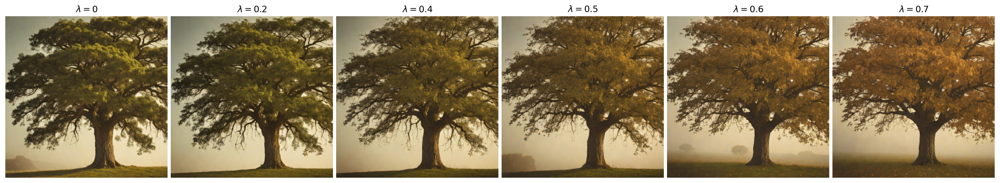

In [8]:

steer_prompt = 'tree with autumn leaves'
prompt = 'A photo of a tree'
guidance_scale = 0.0
num_inference_steps =3
seed=61730

plt.figure(figsize=(24, 6), dpi=300)  # Increase figure size and resolution
strengths = [0, 0.2,0.4,0.5,0.6,0.7] # Include lambda = 0 (strength = 0)

for j, strength in enumerate(strengths):
    plt.subplot(1, len(strengths), j + 1)  # Use dynamic number of subplots
    plt.axis("off")
    plt.imshow(activation_modulation_across_prompt(blocks_to_save, steer_prompt, strength, prompt))
    
    plt.title(rf"$\lambda = {strength}$", fontsize=20)  # Use LaTeX formatting for lambda


# Reduce space between subplots
plt.subplots_adjust(wspace=0.02, hspace=0.02)

# Save the figure
plt.savefig("a.png", bbox_inches='tight', pad_inches=0, dpi=300)

plt.show()


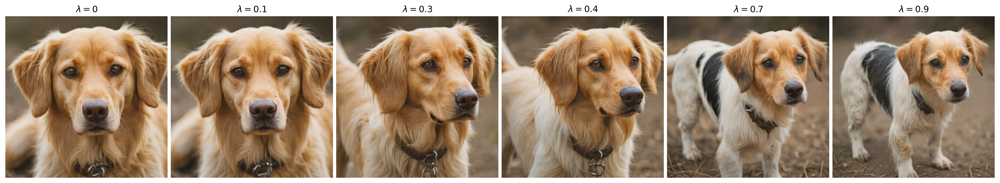

In [10]:
plt.figure(figsize=(24, 6), dpi=300)  # Increase figure size and resolution
strengths = [0, 0.1, 0.3, 0.4, 0.7, 0.9]  # Include lambda = 0 (strength = 0)

for j, strength in enumerate(strengths):
    plt.subplot(1, len(strengths), j + 1)  # Use dynamic number of subplots
    plt.axis("off")
    plt.imshow(activation_modulation_across_prompt(blocks_to_save, 'full shot', strength, "A dog"))
    
    plt.title(rf"$\lambda = {strength}$", fontsize=12)  # Use LaTeX formatting for lambda


# Reduce space between subplots
plt.subplots_adjust(wspace=0.02, hspace=0.02)

# Save the figure
plt.savefig("a.png", bbox_inches='tight', pad_inches=0, dpi=300)

plt.show()


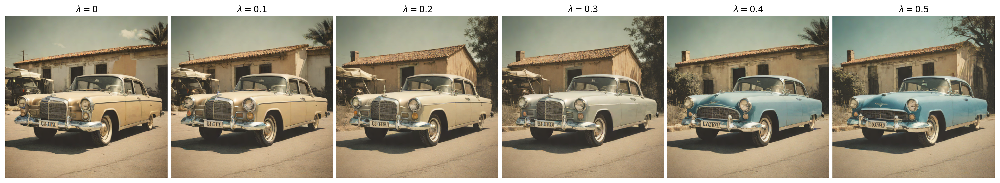

In [30]:
plt.figure(figsize=(24, 6), dpi=300)  # Increase figure size and resolution
strengths = [0, 0.1, 0.2, 0.3, 0.4, 0.5]  # Include lambda = 0 (strength = 0)

for j, strength in enumerate(strengths):
    plt.subplot(1, len(strengths), j + 1)  # Use dynamic number of subplots
    plt.axis("off")
    plt.imshow(activation_modulation_across_prompt(blocks_to_save, 'A blue car', strength, 'A car'))
    
    plt.title(rf"$\lambda = {strength}$", fontsize=12)  # Use LaTeX formatting for lambda


# Reduce space between subplots
plt.subplots_adjust(wspace=0.02, hspace=0.02)

# Save the figure
plt.savefig("a.png", bbox_inches='tight', pad_inches=0, dpi=300)

plt.show()
